# モデルの重みの分布を2次元で可視化

このノートブックでは、LLaDAモデルの重みパラメータを抽出し、その絶対値を2次元で可視化します。

In [1]:
import sys
from pathlib import Path
workspace_root = Path("/work")
if str(workspace_root) not in sys.path:
    sys.path.insert(0, str(workspace_root))

## 1. 必要なライブラリのインポート

可視化に必要なライブラリをインポートします。

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch

## 2. モデルの読み込み

LLaDAModelLMを使用してモデルをロードします。

In [3]:
# モデルのロード
from llada import LLaDAModelLM
model = LLaDAModelLM.from_pretrained("GSAI-ML/LLaDA-8B-Instruct")
# または既存のモデルインスタンスを使用
from dream import DreamModel
dream_model = DreamModel.from_pretrained("Dream-org/Dream-v0-Instruct-7B")

/usr/local/lib/python3.10/dist-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loading checkpoint shards: 100%|██████████| 4/4 [00:03<00:00,  1.26it/s]
/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:629: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.0` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`. This was detected when initializing the generation config instance, which means the corresponding file may hold incorrect parameterization and should be fixed.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:629: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.0` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(


## 3. 重みパラメータの抽出

モデルから特定のレイヤーの重みを抽出します。

model.transformer.wte.weight: torch.Size([126464, 4096])
model.transformer.ln_f.weight: torch.Size([4096])
model.transformer.blocks.0.attn_out.weight: torch.Size([4096, 4096])
model.transformer.blocks.0.ff_out.weight: torch.Size([4096, 12288])
model.transformer.blocks.0.attn_norm.weight: torch.Size([4096])
model.transformer.blocks.0.ff_norm.weight: torch.Size([4096])
model.transformer.blocks.0.q_proj.weight: torch.Size([4096, 4096])
model.transformer.blocks.0.k_proj.weight: torch.Size([4096, 4096])
model.transformer.blocks.0.v_proj.weight: torch.Size([4096, 4096])
model.transformer.blocks.0.ff_proj.weight: torch.Size([12288, 4096])
model.transformer.blocks.0.up_proj.weight: torch.Size([12288, 4096])
model.transformer.blocks.1.attn_out.weight: torch.Size([4096, 4096])
model.transformer.blocks.1.ff_out.weight: torch.Size([4096, 12288])
model.transformer.blocks.1.attn_norm.weight: torch.Size([4096])
model.transformer.blocks.1.ff_norm.weight: torch.Size([4096])
model.transformer.blocks.1.q

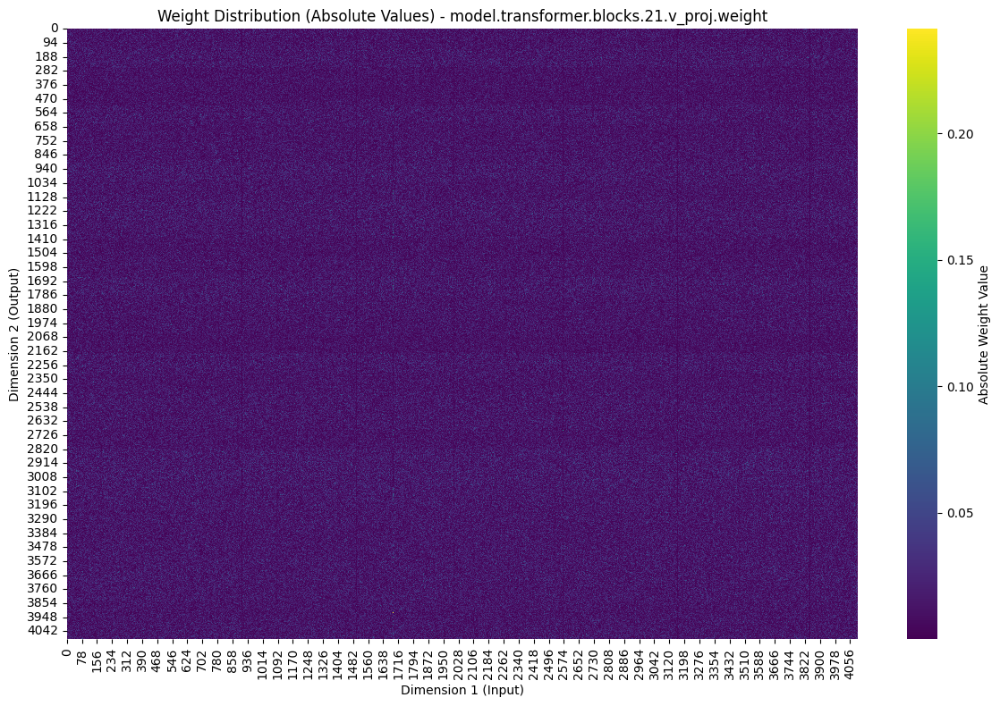

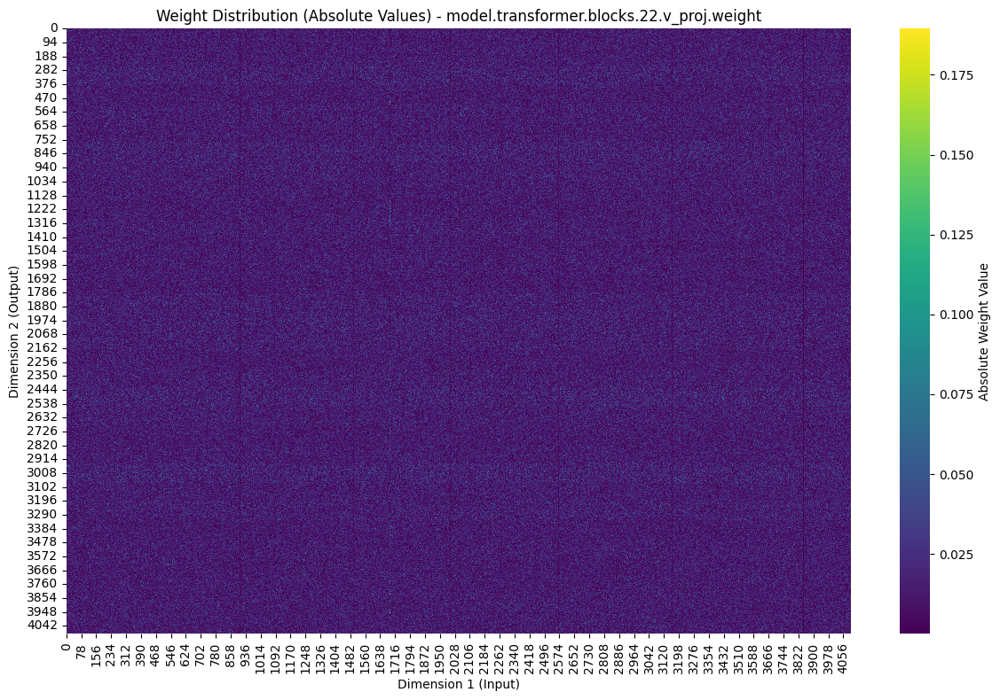

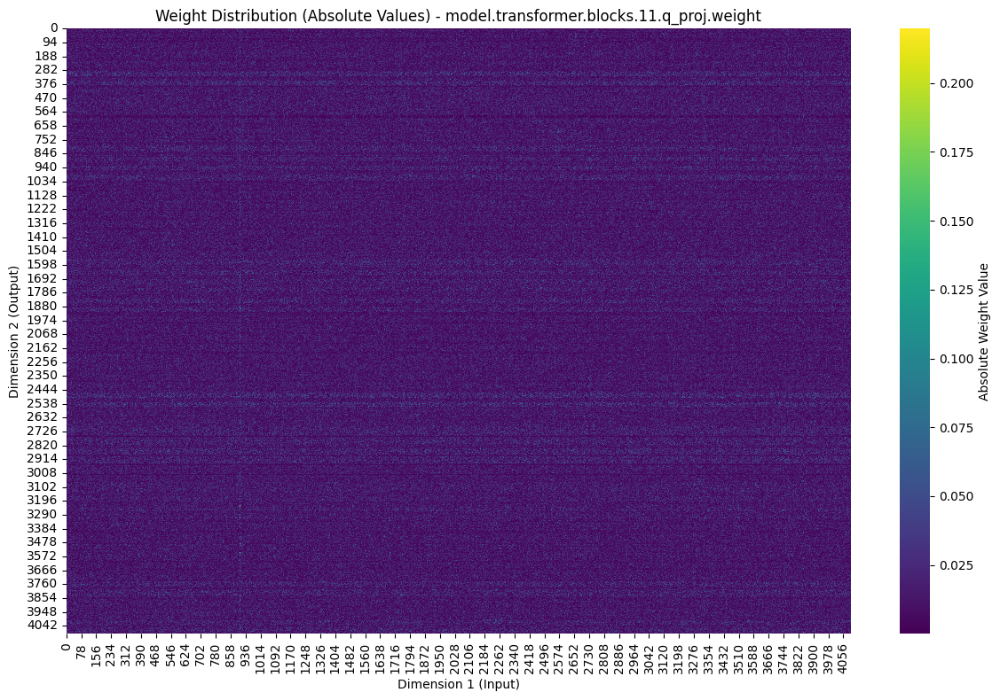

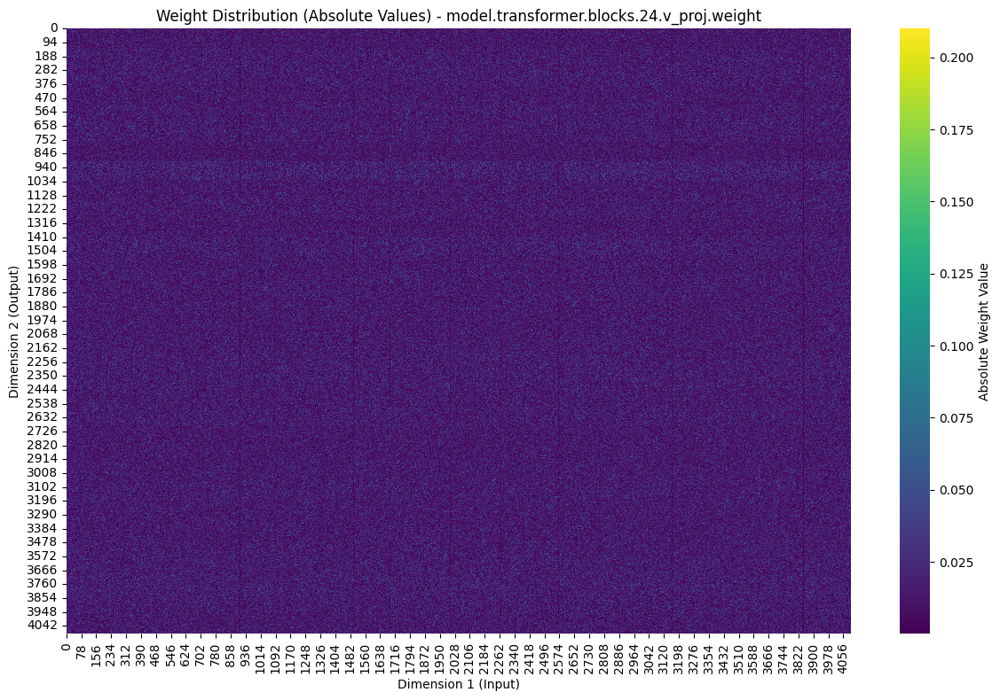

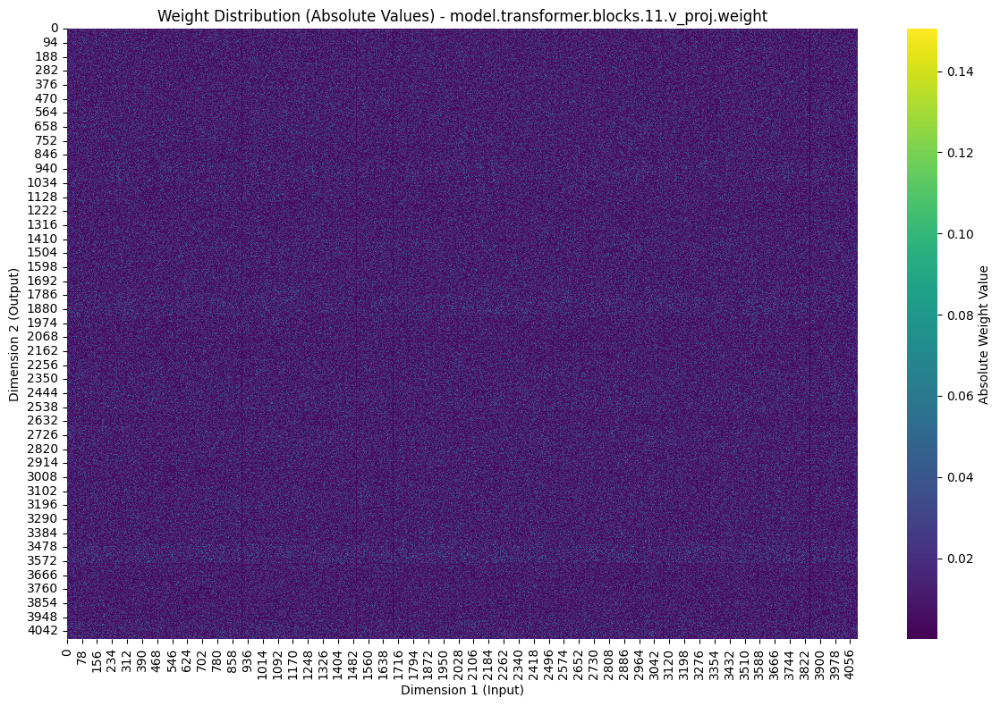

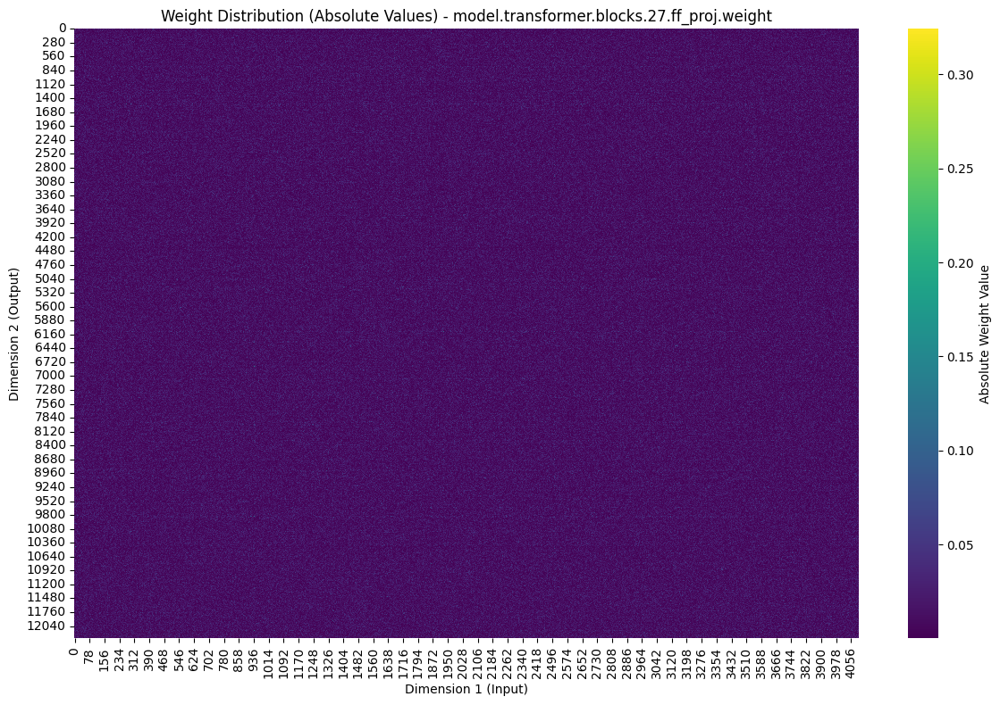

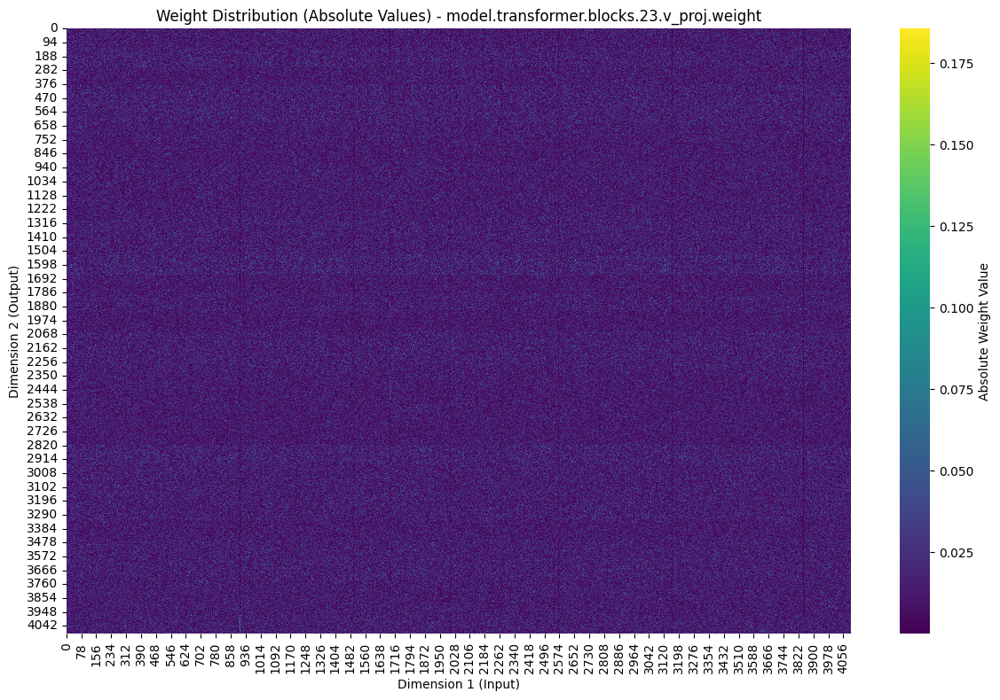

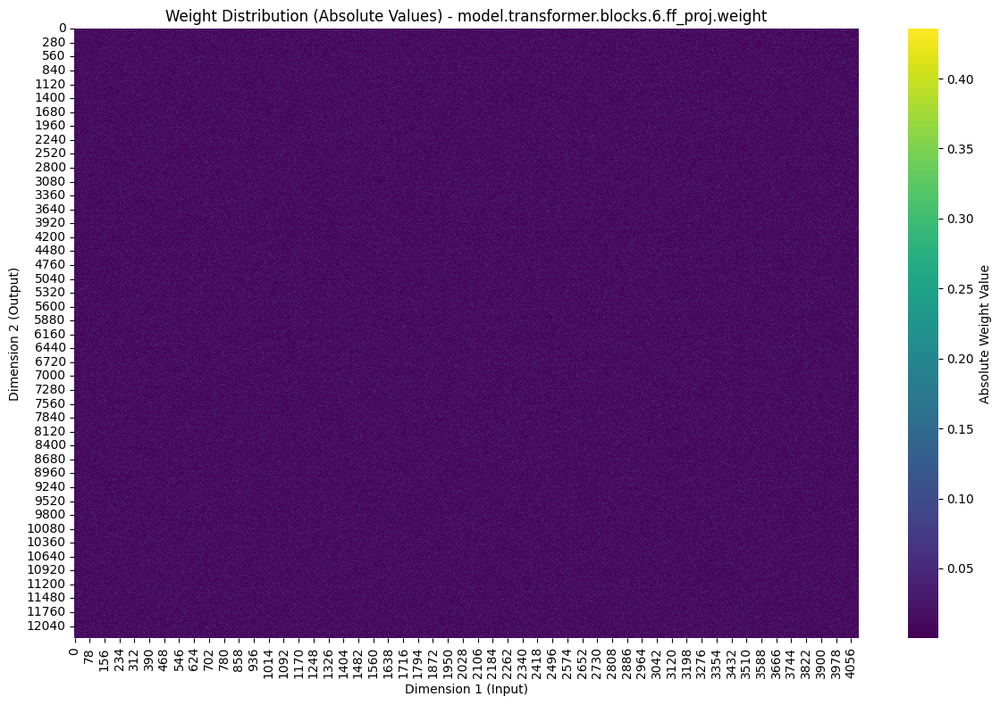

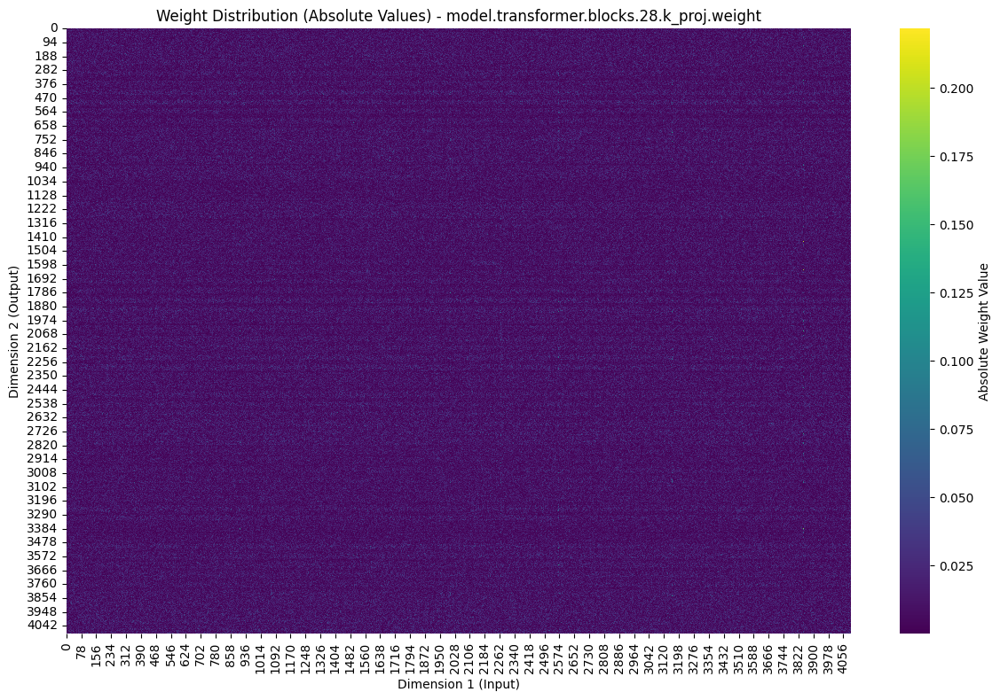

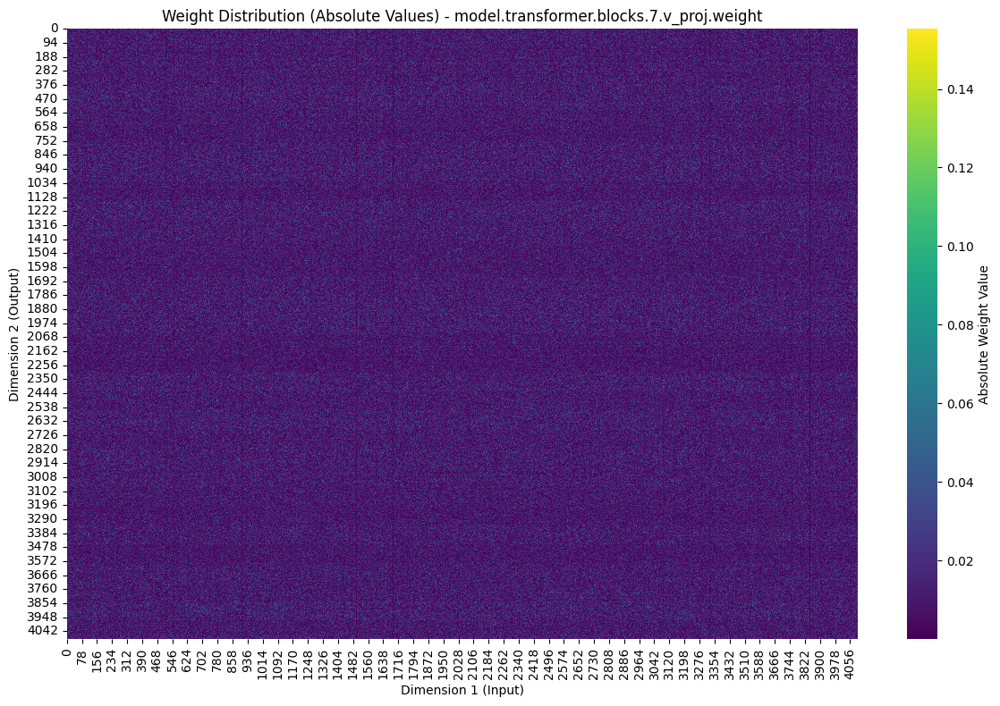

In [4]:
# 全パラメータの名前とshapeを確認
all_weights = []
for name, param in model.named_parameters():
    print(f"{name}: {param.shape}")
    if 'weight' in name and len(param.shape) == 2:
        all_weights.append((name, param))

print(f"\n2次元の重み行列: {len(all_weights)}個")

# ランダムに数個だけ抽出して可視化
import random
num_samples = min(10, len(all_weights))  # 最大5個まで
sampled_weights = random.sample(all_weights, num_samples)

print(f"ランダムに{num_samples}個を可視化します\n")

for name, param in sampled_weights:
    weight_cpu = param.detach().cpu().numpy()
    weight_abs = np.abs(weight_cpu)  # 絶対値

    plt.figure(figsize=(12, 8))
    sns.heatmap(weight_abs, cmap='viridis', cbar_kws={'label': 'Absolute Weight Value'})
    plt.xlabel('Dimension 1 (Input)')
    plt.ylabel('Dimension 2 (Output)')
    plt.title(f'Weight Distribution (Absolute Values) - {name}')
    plt.tight_layout()
    plt.show()

model.embed_tokens.weight: torch.Size([152064, 3584])
model.layers.0.self_attn.q_proj.weight: torch.Size([3584, 3584])
model.layers.0.self_attn.q_proj.bias: torch.Size([3584])
model.layers.0.self_attn.k_proj.weight: torch.Size([512, 3584])
model.layers.0.self_attn.k_proj.bias: torch.Size([512])
model.layers.0.self_attn.v_proj.weight: torch.Size([512, 3584])
model.layers.0.self_attn.v_proj.bias: torch.Size([512])
model.layers.0.self_attn.o_proj.weight: torch.Size([3584, 3584])
model.layers.0.mlp.gate_proj.weight: torch.Size([18944, 3584])
model.layers.0.mlp.up_proj.weight: torch.Size([18944, 3584])
model.layers.0.mlp.down_proj.weight: torch.Size([3584, 18944])
model.layers.0.input_layernorm.weight: torch.Size([3584])
model.layers.0.post_attention_layernorm.weight: torch.Size([3584])
model.layers.1.self_attn.q_proj.weight: torch.Size([3584, 3584])
model.layers.1.self_attn.q_proj.bias: torch.Size([3584])
model.layers.1.self_attn.k_proj.weight: torch.Size([512, 3584])
model.layers.1.self_a

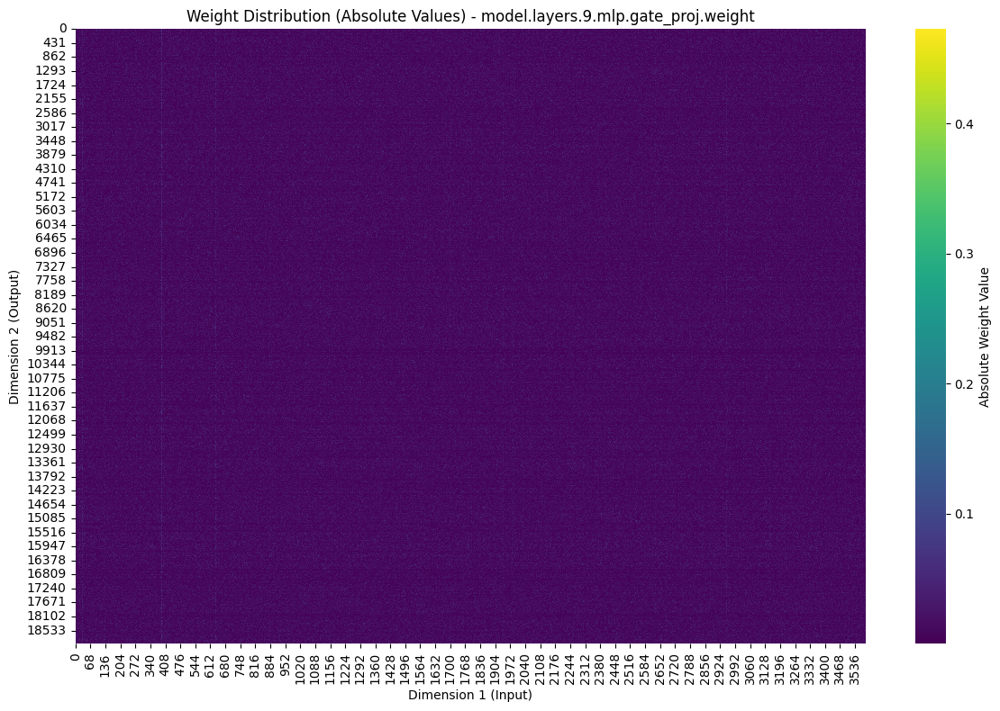

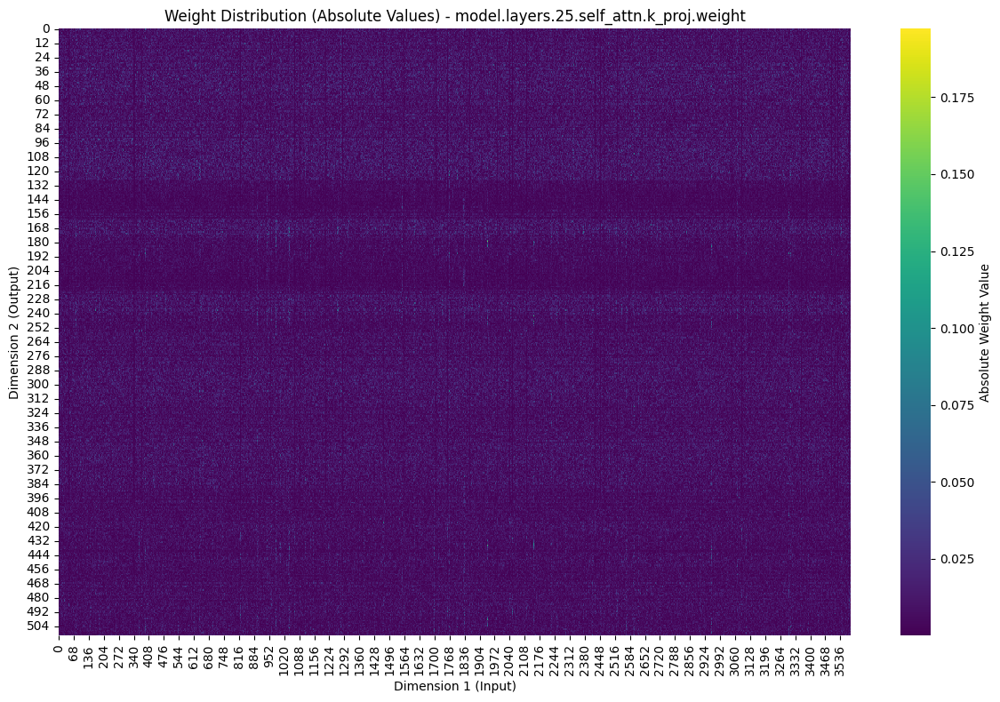

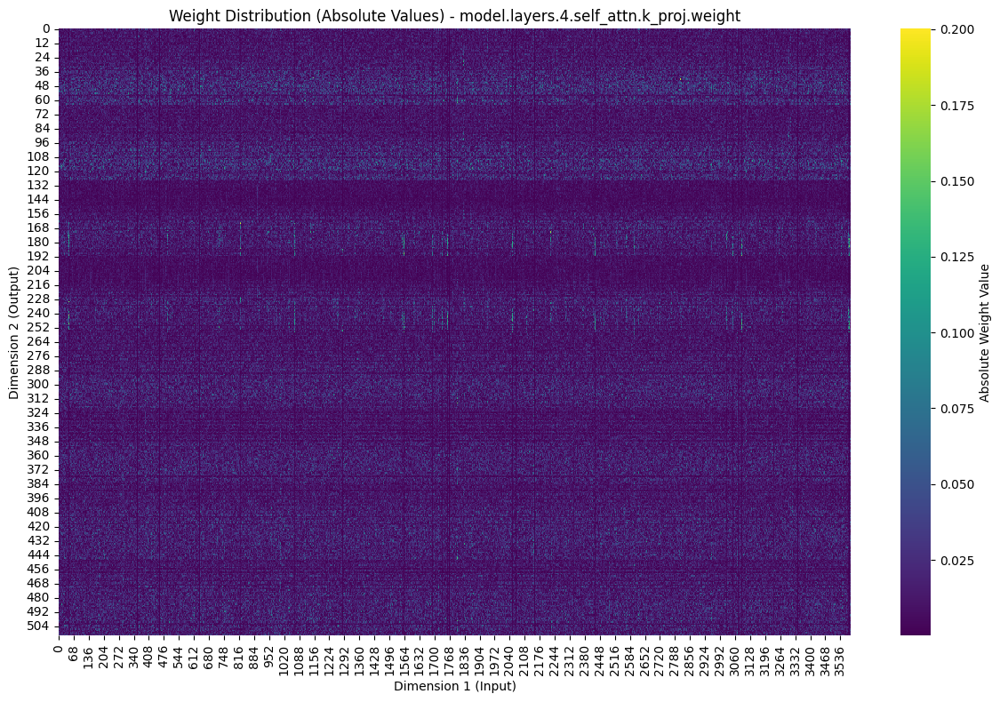

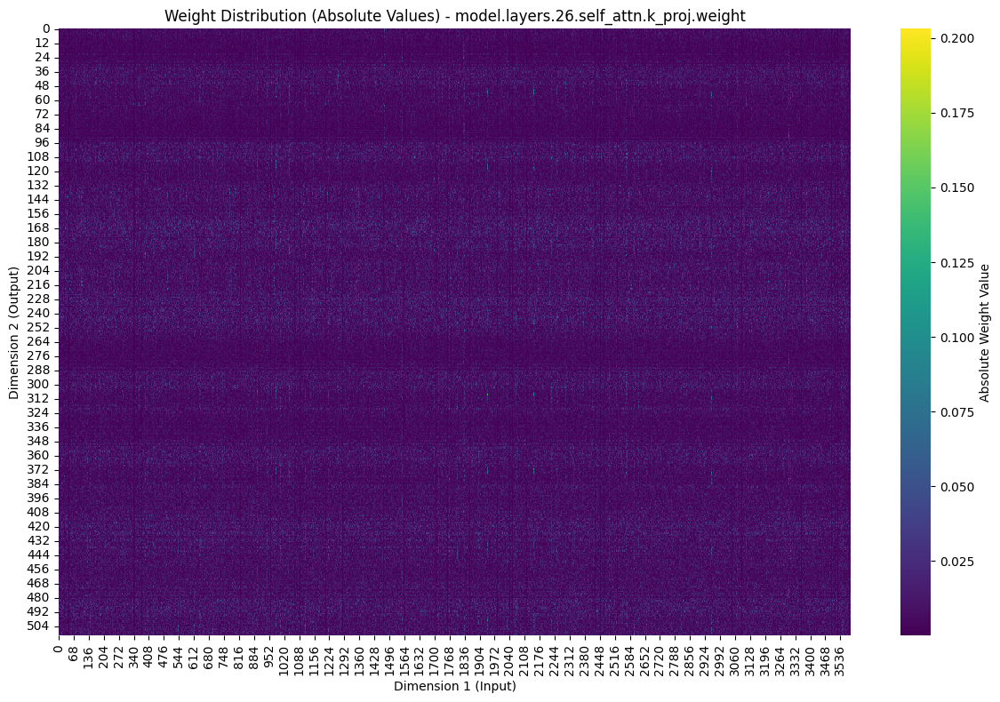

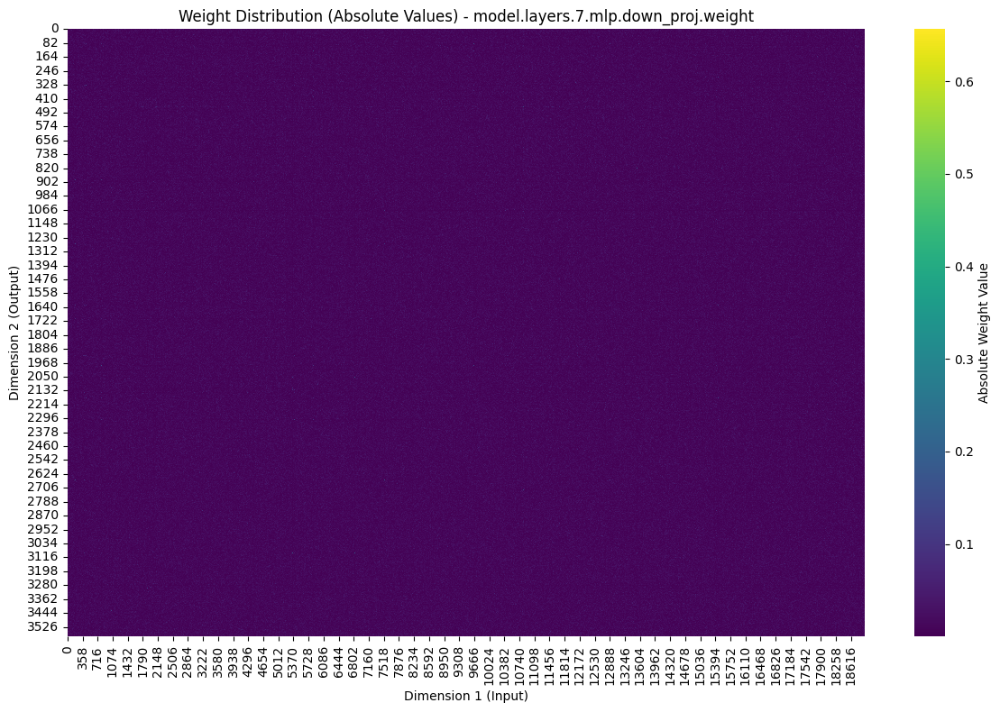

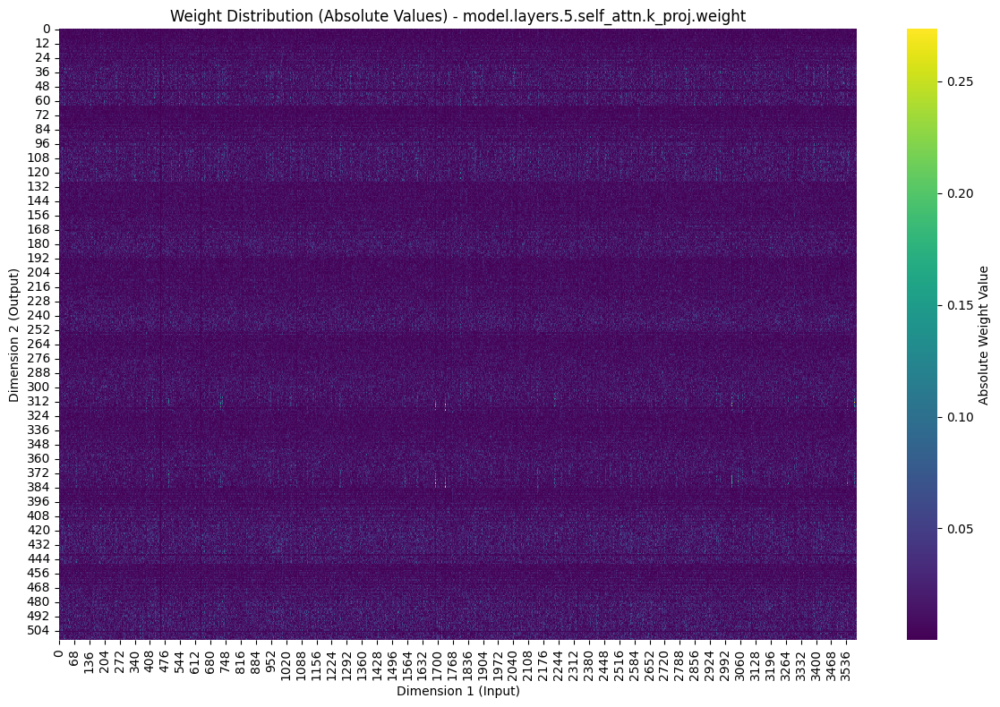

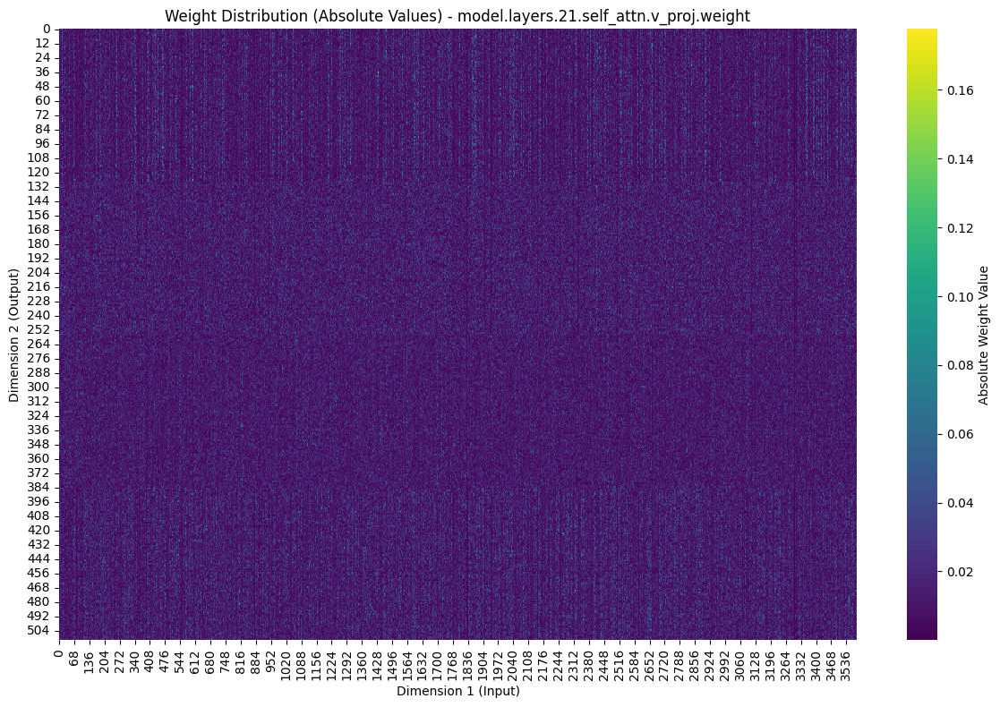

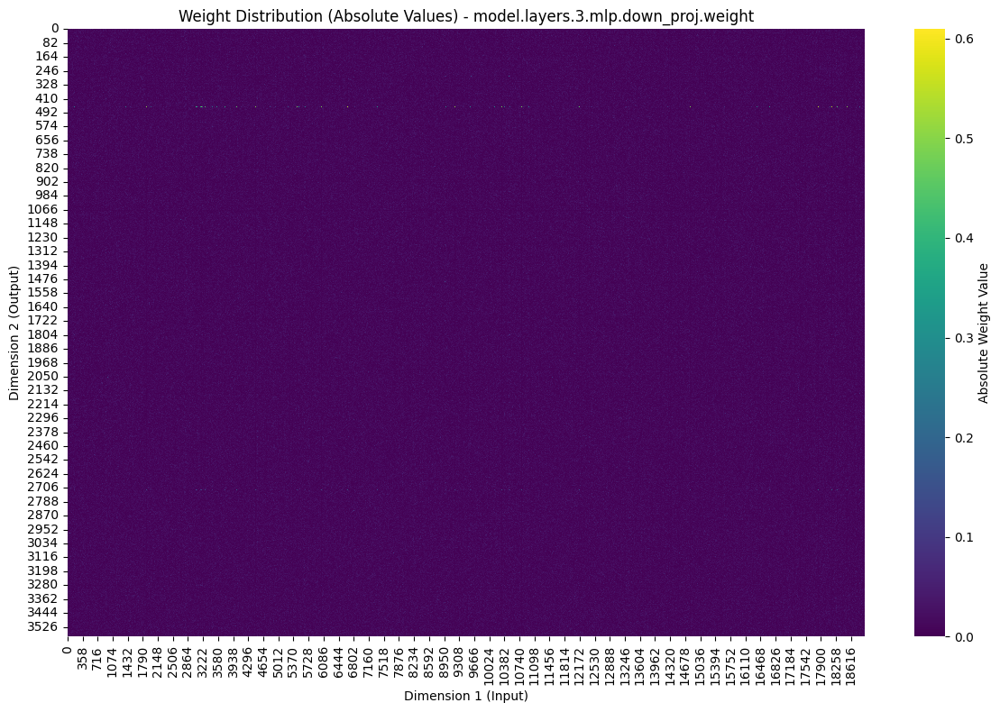

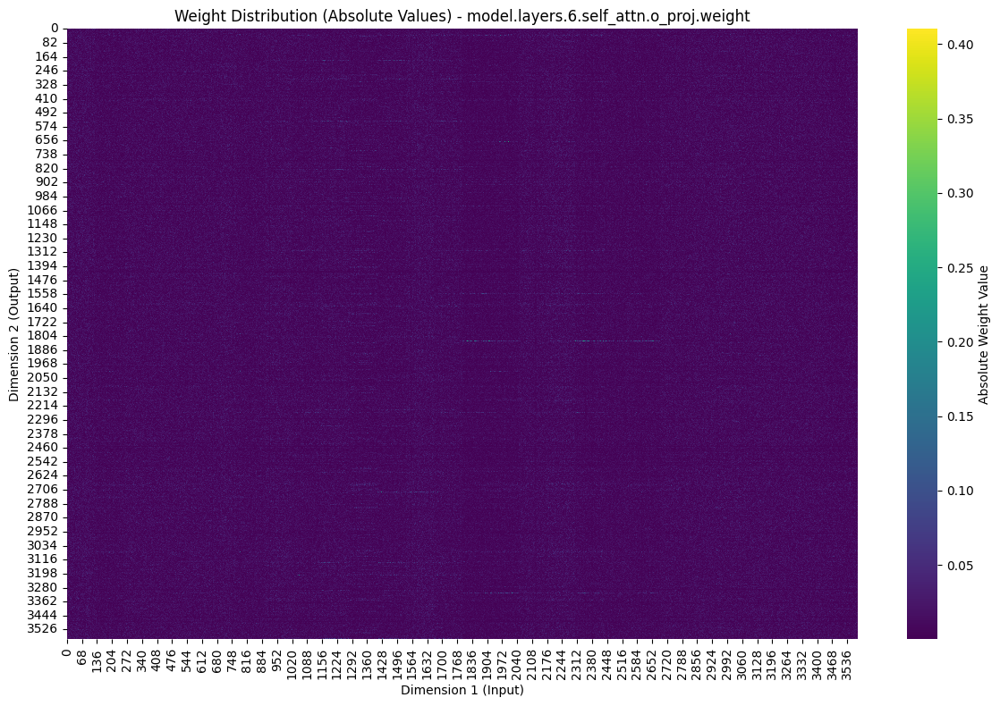

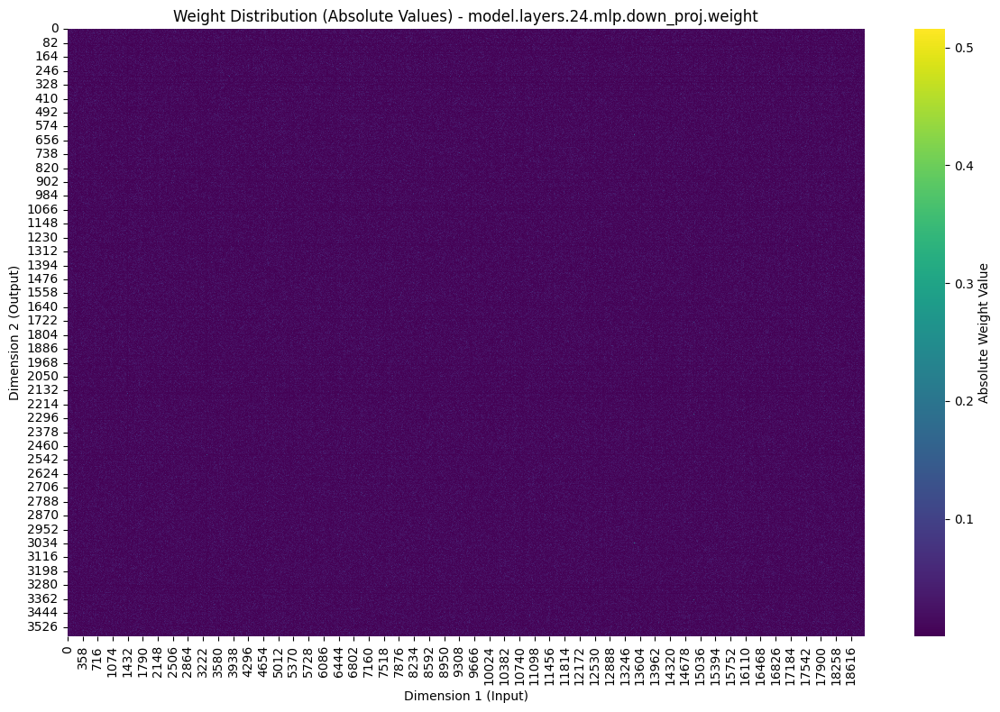

In [5]:
# 全パラメータの名前とshapeを確認
all_weights = []
for name, param in dream_model.named_parameters():
    print(f"{name}: {param.shape}")
    if 'weight' in name and len(param.shape) == 2:
        all_weights.append((name, param))

print(f"\n2次元の重み行列: {len(all_weights)}個")

# ランダムに数個だけ抽出して可視化
import random
num_samples = min(10, len(all_weights))  # 最大5個まで
sampled_weights = random.sample(all_weights, num_samples)

print(f"ランダムに{num_samples}個を可視化します\n")

for name, param in sampled_weights:
    weight_cpu = param.detach().cpu().numpy()
    weight_abs = np.abs(weight_cpu)  # 絶対値

    plt.figure(figsize=(12, 8))
    sns.heatmap(weight_abs, cmap='viridis', cbar_kws={'label': 'Absolute Weight Value'})
    plt.xlabel('Dimension 1 (Input)')
    plt.ylabel('Dimension 2 (Output)')
    plt.title(f'Weight Distribution (Absolute Values) - {name}')
    plt.tight_layout()
    plt.show()